# LSTM Returns One Station

### LIBRERIAS

In [1]:
import pandas as pd
import math
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, TimeDistributed
from tensorflow.keras.losses import mean_squared_error

### CARGA DE COMPLETE RETURNS DF

In [2]:
completeReturnsDf = pd.read_csv('../data/completeData/returns/completeReturnsDf.csv')

In [2]:
completeReturnsDf = pd.read_csv('../data/completeData/returns/completeReturnsDf_LOG1P.csv')

In [3]:
completeReturnsDf['Date'] = pd.to_datetime(completeReturnsDf['Date'])
completeReturnsDf.set_index('Date', inplace=True)

In [4]:
completeWeatherDf = pd.read_csv('../data/completeData/weather/completeWeatherDf.csv')

In [5]:
def getTrainValidationTestStationT24(trainDays, validationDays, station, completeReturnsDf):
    X = completeReturnsDf[[station]].values.reshape(-1,24)
    Y = np.delete(X, 0, 0)
    X = np.delete(X, len(X)-1, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48(trainDays, validationDays, station, completeReturnsDf):
    X_24 = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), 0, 0)
    X_48 = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), len(X_24)-1, 0)
    X = np.delete( np.append( X_48, X_24, axis=1).reshape(-1,2, 24), len(X_24)-1, 0 )

    X_transposed = np.empty((len(X), 24, 2))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), [0,1], 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T168(trainDays, validationDays, station, completeReturnsDf):
    X_24 = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_168 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X = np.append( np.append( X_168, X_48, axis=1), X_24, axis = 1).reshape(-1,3, 24)
    X = np.delete(X, len(X)-1, 0)
    X_transposed = np.empty((len(X), 24, 3))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T144T168(trainDays, validationDays, station, completeReturnsDf):
    X_24 = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_144 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_144 = np.delete(X_144, [[len(X_144)-i for i in range(1, 6)]], 0)
    X_144 = np.delete(X_144, 0, 0)
    X_168 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X = np.append( np.append( X_144, X_48, axis=1), X_24, axis = 1)
    X = np.append(X_168, X, axis=1).reshape(-1,4, 24)
    X = np.delete(X, len(X)-1, 0)
    X_transposed = np.empty((len(X), 24, 4))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T168_ExogVariables(trainDays, validationDays, station, completeReturnsDf, completeWeatherDf):
    X_24 = np.delete(completeReturnsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_168 = completeReturnsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X_temp = np.delete(completeWeatherDf['temp'].values.reshape(-1, 24), [range(0, 7)], 0)
    X_humidity = np.delete(completeWeatherDf['humidity'].values.reshape(-1, 24), [range(0, 7)], 0)

    X = np.append( np.append( X_168, X_48, axis=1), X_24, axis = 1)
    X = np.delete(X, len(X)-1, 0)
    X = np.append( np.append( X_temp, X_humidity, axis=1), X, axis=1).reshape(-1,5, 24)

    X_transposed = np.empty((len(X), 24, 5))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

In [6]:
def plotDayPrediction(predictions, Y, day, log1pData):

    data = pd.DataFrame()
    try:
        if log1pData:
            data['prediction'] = np.round(np.expm1(predictions[day]),0)
            data['real'] = np.expm1(Y[day])
        else:
            data['prediction'] = np.round(predictions[day],0)
            data['real'] = Y[day]
    except:
        print("El dia tiene que ser inferior a {}".format(len(Y)) )

    plt.figure(figsize=(12,5))
    plt.xlabel('Prediction of day ' + str(day))

    ax1 = data.prediction.plot(color='red', grid=True, label='Forecast')
    ax2 = data.real.plot(color='blue', grid=True, label='Actual')
    h1, l1 = ax1.get_legend_handles_labels()

    plt.legend(h1, l1, loc=2)
    plt.show()

In [7]:
def log1p_mse_rmse(Y_test, predictions):
    rmse = 0
    mse = 0
    for i in range(0, len(predictions)):
        mse += mean_squared_error(np.expm1(Y_test[i]), np.expm1(predictions[i]))

    mse /= len(predictions)
    rmse += math.sqrt(mse)
    print("MSE = {}, RMSE = {}".format(mse,rmse))

In [8]:
epochs = 10000
batch_size = 4096

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h

In [90]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24(4000, 105, '31005', completeReturnsDf)

Shape del dataframe 'X_train' --> (4000, 24) // 'X_validation --> (105, 24) //  X_test --> (105, 24)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (105, 24)


In [10]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed (TimeDistri (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
______________________________________________________

In [11]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 4s 4s/step - loss: 1.6120 - mae: 0.5711
Epoch 2/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.6025 - mae: 0.5728
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5931 - mae: 0.5745
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5837 - mae: 0.5762
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5741 - mae: 0.5779
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.5644 - mae: 0.5797
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.5546 - mae: 0.5815
Epoch 8/10000
1/1 [==============================] - 0s 13ms/step - loss: 1.5447 - mae: 0.5833
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5348 - mae: 0.5851
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.5247 - mae: 0.5870
Epoch 11/10000
1/1 [==============================] - 0

In [12]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 0.8491379054523733
 Test loss: 0.7210351824760437
 Test mae: 0.5599814653396606


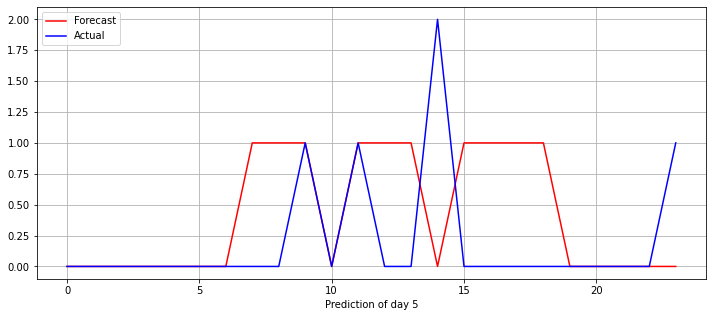

In [14]:
predictions = model.predict(x=X_test.reshape(X_test.shape[0], X_test.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1, 24)
plotDayPrediction(predictions, Y_test, 5, False)

#### LOG1P

In [97]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_18 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
___________________________________________________

In [98]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 978ms/step - loss: 0.2960 - mae: 0.2917
Epoch 2/10000
1/1 [==============================] - 0s 38ms/step - loss: 0.2893 - mae: 0.2943
Epoch 3/10000
1/1 [==============================] - 0s 46ms/step - loss: 0.2830 - mae: 0.2967
Epoch 4/10000
1/1 [==============================] - 0s 36ms/step - loss: 0.2768 - mae: 0.2991
Epoch 5/10000
1/1 [==============================] - 0s 46ms/step - loss: 0.2708 - mae: 0.3014
Epoch 6/10000
1/1 [==============================] - 0s 50ms/step - loss: 0.2651 - mae: 0.3039
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.2597 - mae: 0.3063
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.2546 - mae: 0.3088
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.2496 - mae: 0.3113
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.2449 - mae: 0.3138
Epoch 11/10000
1/1 [=============================

In [99]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 0.41166172754681296
 Test loss: 0.16946537792682648
 Test mae: 0.30115997791290283


MSE = 0.3698224127292633, RMSE = 0.6081302596724351


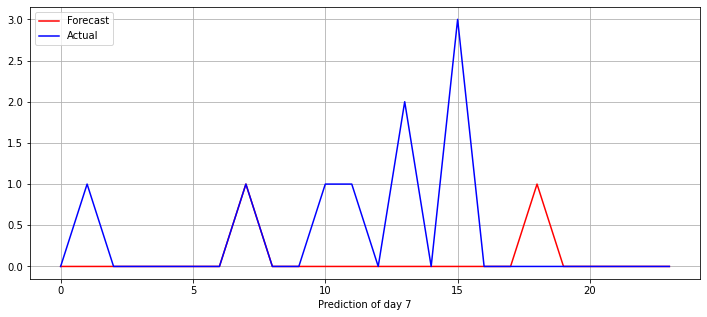

In [100]:
predictions = model.predict(x=X_test.reshape(X_test.shape[0], X_test.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 7, True)

### ESTACION MAS FRECUENTADA

In [101]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24(4000, 105, '31201', completeReturnsDf)

Shape del dataframe 'X_train' --> (4000, 24) // 'X_validation --> (105, 24) //  X_test --> (105, 24)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (105, 24)


#### MODELO BASICO

In [16]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 24, 1)             25        
Total params: 2,521
Trainable params: 2,521
Non-trainable params: 0
_________________________________________________________________
None


In [17]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 897ms/step - loss: 47.2228 - mae: 4.5886
Epoch 2/10000
1/1 [==============================] - 0s 147ms/step - loss: 47.0525 - mae: 4.5743
Epoch 3/10000
1/1 [==============================] - 0s 7ms/step - loss: 46.8588 - mae: 4.5586
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 46.6352 - mae: 4.5412
Epoch 5/10000
1/1 [==============================] - 0s 7ms/step - loss: 46.3737 - mae: 4.5221
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 46.0791 - mae: 4.5019
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 45.7631 - mae: 4.4808
Epoch 8/10000
1/1 [==============================] - 0s 8ms/step - loss: 45.4250 - mae: 4.4582
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 45.0731 - mae: 4.4347
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 44.7144 - mae: 4.4105
Epoch 11/10000
1/1 [=========================

In [18]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5705549595345736
 Test loss: 6.607752799987793
 Test mae: 1.8150250911712646


 Test rmse: 2.2514580135204625
 Test loss: 5.069063186645508
 Test mae: 1.6031460762023926


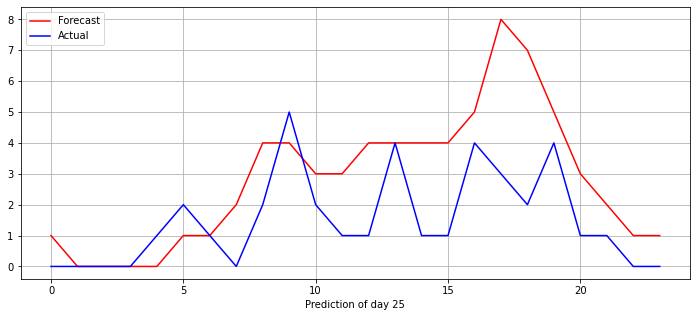

In [22]:
predictions = model.predict(x=X_test.reshape(X_test.shape[0], X_test.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test.reshape(X_test.shape[0], X_test.shape[1], 1), Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 25, False)

#### MODELO MAS DENSO

In [23]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(X_train.shape[1], activation="relu", name="Dense_0")))
model.add(Dense(16, activation='relu', name='Dense_1'))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_2 (TimeDist (None, 24, 24)            600       
_________________________________________________________________
Dense_1 (Dense)              (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)            

In [24]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 949ms/step - loss: 46.6096 - mae: 4.5626
Epoch 2/10000
1/1 [==============================] - 0s 142ms/step - loss: 46.2909 - mae: 4.5434
Epoch 3/10000
1/1 [==============================] - 0s 10ms/step - loss: 45.9731 - mae: 4.5243
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 45.6523 - mae: 4.5049
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 45.3264 - mae: 4.4852
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 44.9927 - mae: 4.4646
Epoch 7/10000
1/1 [==============================] - 0s 11ms/step - loss: 44.6520 - mae: 4.4432
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 44.3079 - mae: 4.4210
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 43.9664 - mae: 4.3984
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 43.6260 - mae: 4.3757
Epoch 11/10000
1/1 [====================

In [25]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5720283323539888
 Test loss: 6.615329742431641
 Test mae: 1.8238126039505005


 Test rmse: 2.2711543518316297
 Test loss: 5.15814208984375
 Test mae: 1.6037732362747192


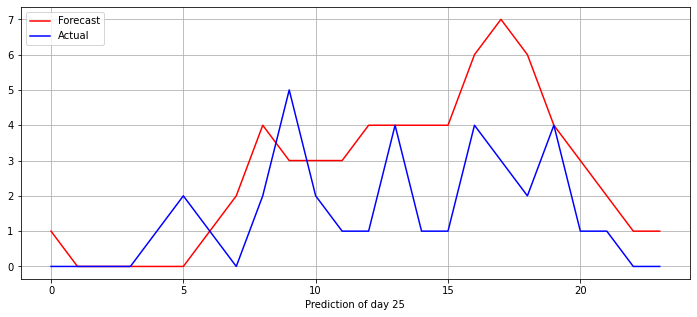

In [27]:
predictions = model.predict(x=X_test.reshape(X_test.shape[0], X_test.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test.reshape(X_test.shape[0], X_test.shape[1], 1), Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 25, False)

#### MODELO MAS DENSO LOG1P

In [102]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_19 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
___________________________________________________

In [103]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 970ms/step - loss: 2.6050 - mae: 1.3017
Epoch 2/10000
1/1 [==============================] - 0s 38ms/step - loss: 2.5952 - mae: 1.2996
Epoch 3/10000
1/1 [==============================] - 0s 42ms/step - loss: 2.5849 - mae: 1.2974
Epoch 4/10000
1/1 [==============================] - 0s 33ms/step - loss: 2.5740 - mae: 1.2950
Epoch 5/10000
1/1 [==============================] - 0s 50ms/step - loss: 2.5628 - mae: 1.2925
Epoch 6/10000
1/1 [==============================] - 0s 44ms/step - loss: 2.5503 - mae: 1.2897
Epoch 7/10000
1/1 [==============================] - 0s 46ms/step - loss: 2.5374 - mae: 1.2868
Epoch 8/10000
1/1 [==============================] - 0s 35ms/step - loss: 2.5244 - mae: 1.2839
Epoch 9/10000
1/1 [==============================] - 0s 11ms/step - loss: 2.5118 - mae: 1.2811
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.4998 - mae: 1.2784
Epoch 11/10000
1/1 [=============================

In [104]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(X_validation, predictions)

 Test rmse: 0.5026165922799843
 Test loss: 0.25262343883514404
 Test mae: 0.39336320757865906
MSE = 3.9764976501464844, RMSE = 1.9941157564561


MSE = 4.229006290435791, RMSE = 2.056454786868846


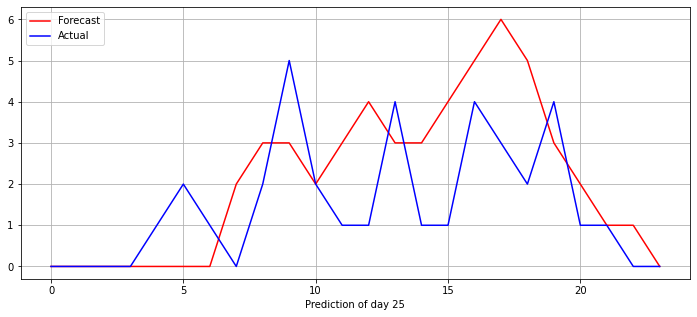

In [105]:
predictions = model.predict(x=X_test.reshape(X_test.shape[0], X_test.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 25, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h & t-48h


In [106]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48(4000, 105, '31201', completeReturnsDf)

Shape del dataframe 'X_train' --> (4000, 24, 2) // 'X_validation --> (105, 24, 2) //  X_test --> (104, 24, 2)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (104, 24)


#### MODELO SIMPLE

In [29]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_3 (TimeDist (None, 24, 1)             25        
Total params: 2,617
Trainable params: 2,617
Non-trainable params: 0
_________________________________________________________________
None


In [30]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 752ms/step - loss: 44.0739 - mae: 4.4084
Epoch 2/10000
1/1 [==============================] - 0s 24ms/step - loss: 43.5559 - mae: 4.3740
Epoch 3/10000
1/1 [==============================] - 0s 24ms/step - loss: 43.0456 - mae: 4.3400
Epoch 4/10000
1/1 [==============================] - 0s 24ms/step - loss: 42.5445 - mae: 4.3064
Epoch 5/10000
1/1 [==============================] - 0s 25ms/step - loss: 42.0537 - mae: 4.2732
Epoch 6/10000
1/1 [==============================] - 0s 14ms/step - loss: 41.5739 - mae: 4.2404
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 41.1052 - mae: 4.2081
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 40.6480 - mae: 4.1763
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 40.2021 - mae: 4.1451
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 39.7675 - mae: 4.1145
Epoch 11/10000
1/1 [======================

In [31]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.513766627093108
 Test loss: 6.3190226554870605
 Test mae: 1.771342158317566


 Test rmse: 2.20204070984423
 Test loss: 4.848983287811279
 Test mae: 1.5606327056884766


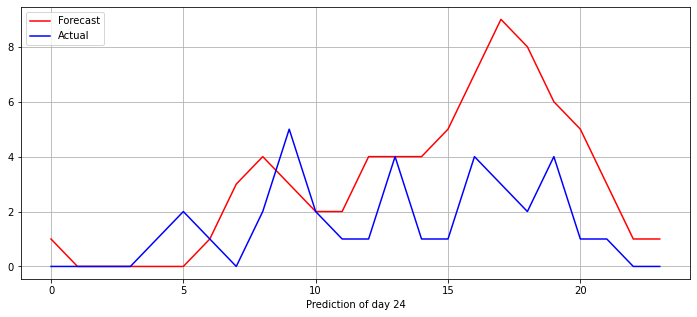

In [32]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 24, False)

#### MODELO MAS DENSO

In [43]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_7 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,177
Trainable params: 3,177
Non-trainable params: 0
____________________________________________________

In [44]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 975ms/step - loss: 47.3738 - mae: 4.6017
Epoch 2/10000
1/1 [==============================] - 0s 69ms/step - loss: 47.3676 - mae: 4.6014
Epoch 3/10000
1/1 [==============================] - 0s 55ms/step - loss: 47.3597 - mae: 4.6009
Epoch 4/10000
1/1 [==============================] - 0s 11ms/step - loss: 47.3494 - mae: 4.6002
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 47.3364 - mae: 4.5993
Epoch 6/10000
1/1 [==============================] - 0s 11ms/step - loss: 47.3198 - mae: 4.5981
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.2987 - mae: 4.5966
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.2718 - mae: 4.5945
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 47.2376 - mae: 4.5919
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 47.1945 - mae: 4.5887
Epoch 11/10000
1/1 [======================

In [47]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5065794197922058
 Test loss: 6.28294038772583
 Test mae: 1.768025279045105


 Test rmse: 2.129848782539929
 Test loss: 4.536255836486816
 Test mae: 1.5162588357925415


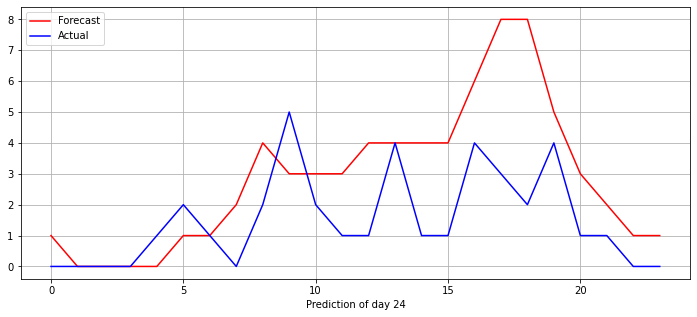

In [48]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 24, False)

#### MODELO SIMPLE LOG1P

In [107]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_20 (TimeDis (None, 24, 1)             25        
Total params: 2,617
Trainable params: 2,617
Non-trainable params: 0
_________________________________________________________________
None


In [108]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 898ms/step - loss: 1.7800 - mae: 1.0814
Epoch 2/10000
1/1 [==============================] - 0s 65ms/step - loss: 1.6995 - mae: 1.0567
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.6225 - mae: 1.0322
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5486 - mae: 1.0081
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.4777 - mae: 0.9845
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.4097 - mae: 0.9616
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.3444 - mae: 0.9392
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.2818 - mae: 0.9174
Epoch 9/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.2218 - mae: 0.8960
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.1643 - mae: 0.8749
Epoch 11/10000
1/1 [==============================] -

In [112]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.497039479196846
 Test loss: 0.2470482438802719
 Test mae: 0.38526538014411926
MSE = 6.23233699798584, RMSE = 2.4964649002110644


MSE = 4.418852806091309, RMSE = 2.1021067542090504


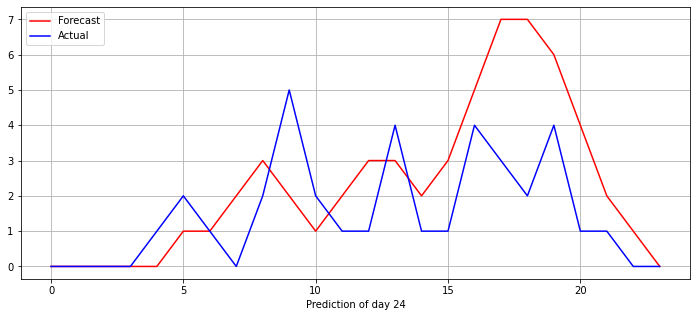

In [113]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 24, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h & t-168h

In [114]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168(4000, 102, '31201', completeReturnsDf)

Shape del dataframe 'X_train' --> (4000, 24, 3) // 'X_validation --> (102, 24, 3) //  X_test --> (102, 24, 3)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [50]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_8 (TimeDist (None, 24, 1)             25        
Total params: 2,713
Trainable params: 2,713
Non-trainable params: 0
_________________________________________________________________
None


In [51]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 756ms/step - loss: 46.8324 - mae: 4.5745
Epoch 2/10000
1/1 [==============================] - 0s 58ms/step - loss: 46.4529 - mae: 4.5505
Epoch 3/10000
1/1 [==============================] - 0s 66ms/step - loss: 46.0462 - mae: 4.5241
Epoch 4/10000
1/1 [==============================] - 0s 56ms/step - loss: 45.6173 - mae: 4.4958
Epoch 5/10000
1/1 [==============================] - 0s 14ms/step - loss: 45.1724 - mae: 4.4662
Epoch 6/10000
1/1 [==============================] - 0s 6ms/step - loss: 44.7180 - mae: 4.4358
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 44.2603 - mae: 4.4049
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 43.8041 - mae: 4.3740
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 43.3520 - mae: 4.3430
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 42.9053 - mae: 4.3121
Epoch 11/10000
1/1 [=======================

In [52]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.4628632292104893
 Test loss: 6.065695285797119
 Test mae: 1.7150102853775024


 Test rmse: 2.0620469260366026
 Test loss: 4.252037525177002
 Test mae: 1.4331095218658447


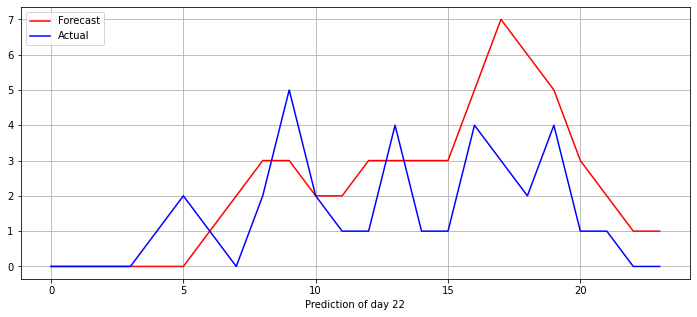

In [55]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [67]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_11 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,273
Trainable params: 3,273
Non-trainable params: 0
___________________________________________________

In [68]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 834ms/step - loss: 47.4058 - mae: 4.6054
Epoch 2/10000
1/1 [==============================] - 0s 48ms/step - loss: 47.3933 - mae: 4.6048
Epoch 3/10000
1/1 [==============================] - 0s 48ms/step - loss: 47.3836 - mae: 4.6044
Epoch 4/10000
1/1 [==============================] - 0s 45ms/step - loss: 47.3697 - mae: 4.6037
Epoch 5/10000
1/1 [==============================] - 0s 35ms/step - loss: 47.3524 - mae: 4.6029
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.3309 - mae: 4.6019
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 47.3047 - mae: 4.6007
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.2730 - mae: 4.5991
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.2350 - mae: 4.5971
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 47.1896 - mae: 4.5947
Epoch 11/10000
1/1 [=====================

In [69]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)

for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.429291033519267
 Test loss: 5.901454925537109
 Test mae: 1.7018332481384277


 Test rmse: 2.1041756305566595
 Test loss: 4.427555084228516
 Test mae: 1.4589619636535645


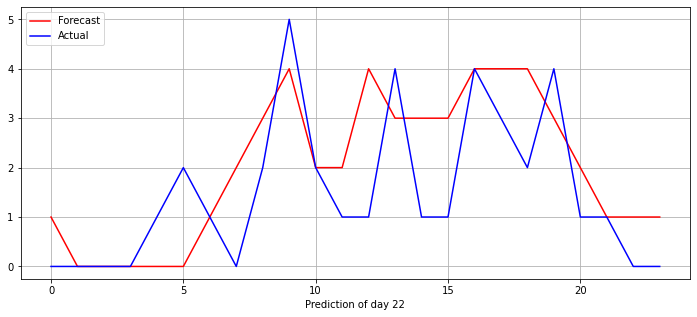

In [70]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO LOG1P

In [115]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_21 (TimeDis (None, 24, 1)             25        
Total params: 2,713
Trainable params: 2,713
Non-trainable params: 0
_________________________________________________________________
None


In [116]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.0220 - mae: 0.8162
Epoch 2/10000
1/1 [==============================] - 0s 107ms/step - loss: 0.9524 - mae: 0.7881
Epoch 3/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8890 - mae: 0.7617
Epoch 4/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.8310 - mae: 0.7368
Epoch 5/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.7783 - mae: 0.7133
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.7306 - mae: 0.6913
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.6875 - mae: 0.6708
Epoch 8/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.6489 - mae: 0.6517
Epoch 9/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.6145 - mae: 0.6341
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.5841 - mae: 0.6180
Epoch 11/10000
1/1 [==============================] - 0s 8

In [120]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.47684420404950706
 Test loss: 0.2273803949356079
 Test mae: 0.3670874834060669
MSE = 5.528707504272461, RMSE = 2.351320374656006


MSE = 4.243251323699951, RMSE = 2.0599153680916


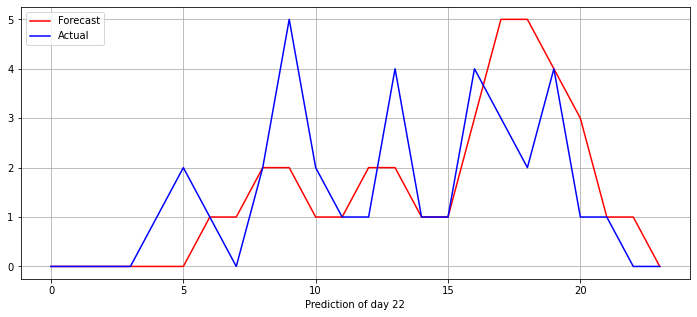

In [121]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO LOG1P MAS DENSO

In [127]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_23 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,273
Trainable params: 3,273
Non-trainable params: 0
___________________________________________________

In [128]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 967ms/step - loss: 1.6912 - mae: 1.0556
Epoch 2/10000
1/1 [==============================] - 0s 37ms/step - loss: 1.5824 - mae: 1.0221
Epoch 3/10000
1/1 [==============================] - 0s 46ms/step - loss: 1.4767 - mae: 0.9880
Epoch 4/10000
1/1 [==============================] - 0s 50ms/step - loss: 1.3724 - mae: 0.9529
Epoch 5/10000
1/1 [==============================] - 0s 48ms/step - loss: 1.2697 - mae: 0.9180
Epoch 6/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.1692 - mae: 0.8833
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.0707 - mae: 0.8478
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.9742 - mae: 0.8111
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.8809 - mae: 0.7731
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.7917 - mae: 0.7348
Epoch 11/10000
1/1 [=============================

In [129]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.47811299726592044
 Test loss: 0.22859203815460205
 Test mae: 0.37047022581100464
MSE = 5.620895862579346, RMSE = 2.370842859107146


MSE = 3.8892548084259033, RMSE = 1.9721193697202772


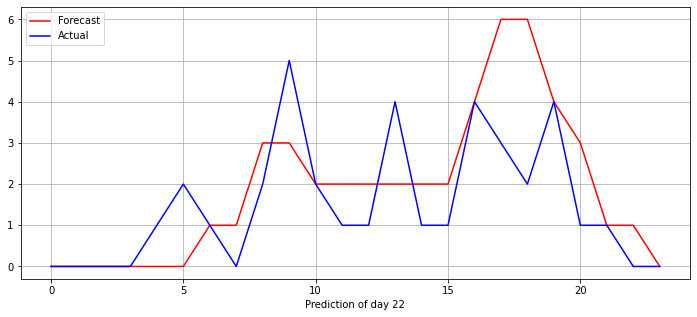

In [130]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, 1-48h & t-168h + Exogenous Variables

In [131]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31201', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [61]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_10 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [62]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 42.7868 - mae: 4.3137
Epoch 2/10000
1/1 [==============================] - 0s 25ms/step - loss: 42.5602 - mae: 4.2994
Epoch 3/10000
1/1 [==============================] - 0s 25ms/step - loss: 42.3351 - mae: 4.2853
Epoch 4/10000
1/1 [==============================] - 0s 25ms/step - loss: 42.1116 - mae: 4.2712
Epoch 5/10000
1/1 [==============================] - 0s 25ms/step - loss: 41.8899 - mae: 4.2573
Epoch 6/10000
1/1 [==============================] - 0s 25ms/step - loss: 41.6703 - mae: 4.2435
Epoch 7/10000
1/1 [==============================] - 0s 24ms/step - loss: 41.4526 - mae: 4.2300
Epoch 8/10000
1/1 [==============================] - 0s 25ms/step - loss: 41.2365 - mae: 4.2166
Epoch 9/10000
1/1 [==============================] - 0s 25ms/step - loss: 41.0216 - mae: 4.2034
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 40.8076 - mae: 4.1904
Epoch 11/10000
1/1 [=====================

In [63]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.4080268937697027
 Test loss: 5.798593521118164
 Test mae: 1.723637342453003


 Test rmse: 2.0214938103644533
 Test loss: 4.086437225341797
 Test mae: 1.3871175050735474


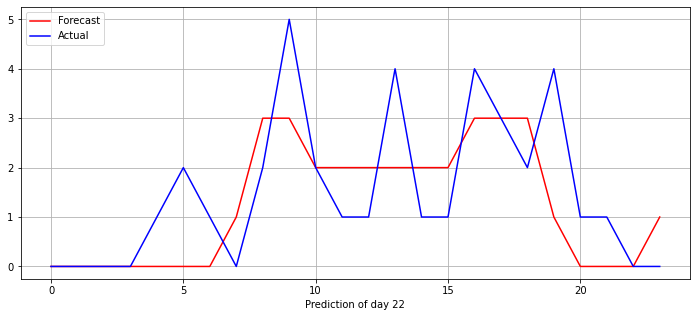

In [65]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [72]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_12 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [73]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 47.3930 - mae: 4.6049
Epoch 2/10000
1/1 [==============================] - 0s 41ms/step - loss: 47.3744 - mae: 4.6041
Epoch 3/10000
1/1 [==============================] - 0s 47ms/step - loss: 47.3570 - mae: 4.6034
Epoch 4/10000
1/1 [==============================] - 0s 13ms/step - loss: 47.3377 - mae: 4.6026
Epoch 5/10000
1/1 [==============================] - 0s 13ms/step - loss: 47.3163 - mae: 4.6016
Epoch 6/10000
1/1 [==============================] - 0s 15ms/step - loss: 47.2924 - mae: 4.6004
Epoch 7/10000
1/1 [==============================] - 0s 12ms/step - loss: 47.2658 - mae: 4.5991
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 47.2363 - mae: 4.5976
Epoch 9/10000
1/1 [==============================] - 0s 12ms/step - loss: 47.2038 - mae: 4.5959
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 47.1690 - mae: 4.5941
Epoch 11/10000
1/1 [=====================

In [74]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.411892010860354
 Test loss: 5.817223072052002
 Test mae: 1.736885666847229


 Test rmse: 2.0029014760248076
 Test loss: 4.0116143226623535
 Test mae: 1.3814486265182495


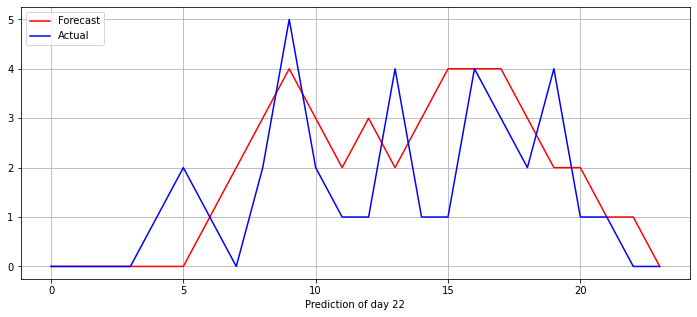

In [76]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO SIMPLE LOG1P

In [160]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_31 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [161]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 722ms/step - loss: 1.3193 - mae: 0.9745
Epoch 2/10000
1/1 [==============================] - 0s 25ms/step - loss: 1.2642 - mae: 0.9545
Epoch 3/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.2129 - mae: 0.9353
Epoch 4/10000
1/1 [==============================] - 0s 25ms/step - loss: 1.1651 - mae: 0.9176
Epoch 5/10000
1/1 [==============================] - 0s 38ms/step - loss: 1.1204 - mae: 0.9016
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.0786 - mae: 0.8868
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.0395 - mae: 0.8728
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.0031 - mae: 0.8592
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.9692 - mae: 0.8459
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.9378 - mae: 0.8332
Epoch 11/10000
1/1 [==============================]

In [162]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.47190898747600935
 Test loss: 0.22269809246063232
 Test mae: 0.3619774878025055
MSE = 5.142262935638428, RMSE = 2.2676558238935702


MSE = 3.6808021068573, RMSE = 1.9185416614859578


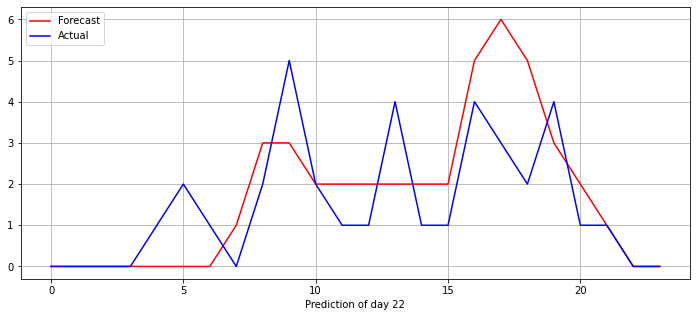

In [163]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO DENSO LOG1P

In [150]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_29"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_29 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [151]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 970ms/step - loss: 2.5946 - mae: 1.2999
Epoch 2/10000
1/1 [==============================] - 0s 39ms/step - loss: 2.5792 - mae: 1.2963
Epoch 3/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.5597 - mae: 1.2919
Epoch 4/10000
1/1 [==============================] - 0s 48ms/step - loss: 2.5391 - mae: 1.2871
Epoch 5/10000
1/1 [==============================] - 0s 45ms/step - loss: 2.5163 - mae: 1.2820
Epoch 6/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.4891 - mae: 1.2761
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.4602 - mae: 1.2705
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 2.4296 - mae: 1.2649
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.3997 - mae: 1.2593
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.3706 - mae: 1.2535
Epoch 11/10000
1/1 [=============================

In [152]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.4736095304764182
 Test loss: 0.22430598735809326
 Test mae: 0.3618806302547455
MSE = 5.177487373352051, RMSE = 2.275409276009934


MSE = 3.6053476333618164, RMSE = 1.8987752982809252


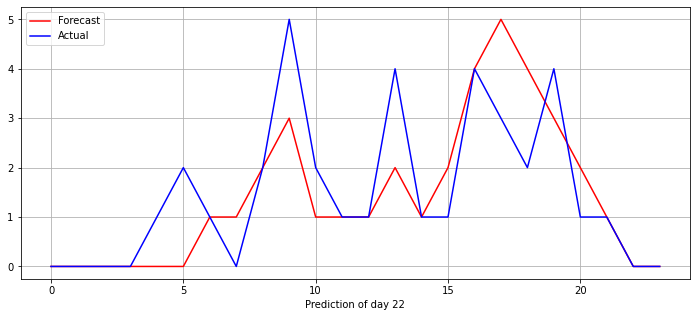

In [153]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h, t-144h & t-168h

In [164]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T144T168(4000, 102, '31201', completeReturnsDf)

Shape del dataframe 'X_train' --> (4000, 24, 4) // 'X_validation --> (102, 24, 4) //  X_test --> (102, 24, 4)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [78]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_13 (TimeDis (None, 24, 1)             25        
Total params: 2,809
Trainable params: 2,809
Non-trainable params: 0
_________________________________________________________________
None


In [79]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 932ms/step - loss: 47.3004 - mae: 4.6021
Epoch 2/10000
1/1 [==============================] - 0s 121ms/step - loss: 47.1808 - mae: 4.5967
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.0350 - mae: 4.5893
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 46.8599 - mae: 4.5798
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 46.6534 - mae: 4.5679
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 46.4175 - mae: 4.5536
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 46.1517 - mae: 4.5369
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 45.8576 - mae: 4.5179
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 45.5372 - mae: 4.4967
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 45.1922 - mae: 4.4735
Epoch 11/10000
1/1 [======================

In [80]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.449089570114296
 Test loss: 5.998039722442627
 Test mae: 1.7279675006866455


 Test rmse: 2.046784377093962
 Test loss: 4.189326286315918
 Test mae: 1.4201874732971191


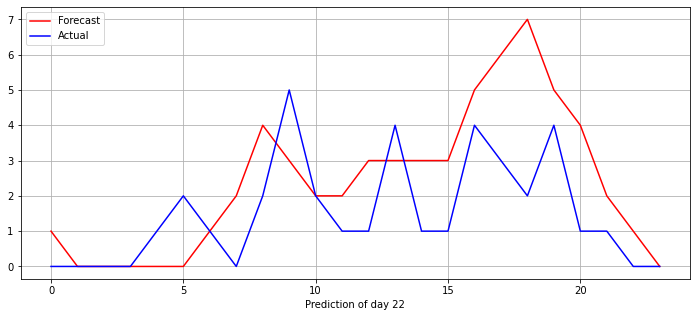

In [81]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [82]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_14 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,369
Trainable params: 3,369
Non-trainable params: 0
___________________________________________________

In [83]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 47.4059 - mae: 4.6054
Epoch 2/10000
1/1 [==============================] - 0s 33ms/step - loss: 47.3983 - mae: 4.6051
Epoch 3/10000
1/1 [==============================] - 0s 44ms/step - loss: 47.3917 - mae: 4.6047
Epoch 4/10000
1/1 [==============================] - 0s 47ms/step - loss: 47.3819 - mae: 4.6042
Epoch 5/10000
1/1 [==============================] - 0s 35ms/step - loss: 47.3696 - mae: 4.6036
Epoch 6/10000
1/1 [==============================] - 0s 20ms/step - loss: 47.3555 - mae: 4.6028
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 47.3406 - mae: 4.6021
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 47.3261 - mae: 4.6014
Epoch 9/10000
1/1 [==============================] - 0s 11ms/step - loss: 47.3120 - mae: 4.6007
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 47.2973 - mae: 4.6000
Epoch 11/10000
1/1 [======================

In [84]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.4465125311166687
 Test loss: 5.985423564910889
 Test mae: 1.7241500616073608


 Test rmse: 2.0827917030709884
 Test loss: 4.338021278381348
 Test mae: 1.4428194761276245


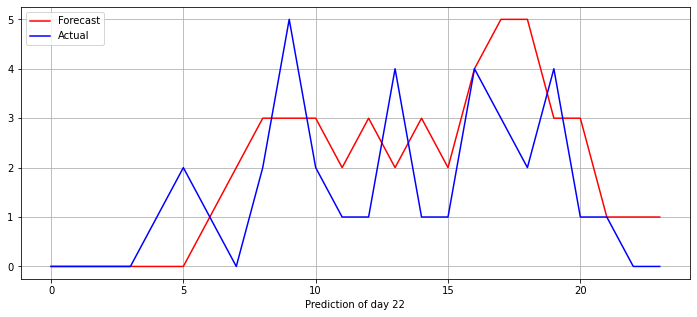

In [86]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO SIMPLE LOG1P

In [165]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_32 (TimeDis (None, 24, 1)             25        
Total params: 2,809
Trainable params: 2,809
Non-trainable params: 0
_________________________________________________________________
None


In [166]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 725ms/step - loss: 2.6084 - mae: 1.3037
Epoch 2/10000
1/1 [==============================] - 0s 58ms/step - loss: 2.6069 - mae: 1.3037
Epoch 3/10000
1/1 [==============================] - 0s 57ms/step - loss: 2.6049 - mae: 1.3037
Epoch 4/10000
1/1 [==============================] - 0s 76ms/step - loss: 2.6022 - mae: 1.3035
Epoch 5/10000
1/1 [==============================] - 0s 26ms/step - loss: 2.5986 - mae: 1.3030
Epoch 6/10000
1/1 [==============================] - 0s 8ms/step - loss: 2.5939 - mae: 1.3023
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.5877 - mae: 1.3011
Epoch 8/10000
1/1 [==============================] - 0s 8ms/step - loss: 2.5795 - mae: 1.2994
Epoch 9/10000
1/1 [==============================] - 0s 6ms/step - loss: 2.5683 - mae: 1.2970
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 2.5533 - mae: 1.2935
Epoch 11/10000
1/1 [==============================] 

In [168]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.48208288104806235
 Test loss: 0.23240390419960022
 Test mae: 0.37201035022735596
MSE = 5.889211177825928, RMSE = 2.4267697002035296


MSE = 3.989720582962036, RMSE = 1.9974284925779036


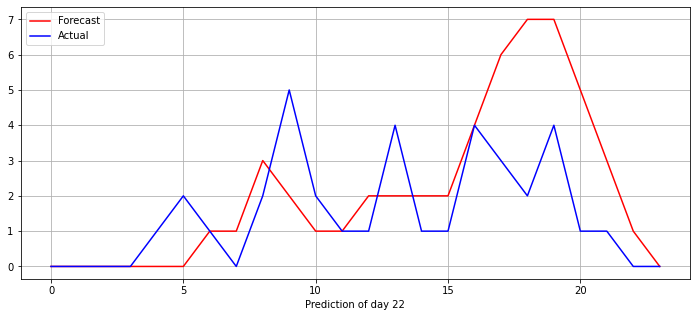

In [169]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO MAS DENSO LOG1P

In [174]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_35"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_35 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,369
Trainable params: 3,369
Non-trainable params: 0
___________________________________________________

In [175]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 2.6098 - mae: 1.3035
Epoch 2/10000
1/1 [==============================] - 0s 40ms/step - loss: 2.6088 - mae: 1.3034
Epoch 3/10000
1/1 [==============================] - 0s 45ms/step - loss: 2.6075 - mae: 1.3031
Epoch 4/10000
1/1 [==============================] - 0s 48ms/step - loss: 2.6054 - mae: 1.3027
Epoch 5/10000
1/1 [==============================] - 0s 54ms/step - loss: 2.6031 - mae: 1.3023
Epoch 6/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.6013 - mae: 1.3019
Epoch 7/10000
1/1 [==============================] - 0s 32ms/step - loss: 2.5994 - mae: 1.3016
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.5974 - mae: 1.3012
Epoch 9/10000
1/1 [==============================] - 0s 14ms/step - loss: 2.5953 - mae: 1.3008
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 2.5932 - mae: 1.3004
Epoch 11/10000
1/1 [==============================] 

In [176]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.47706216663842216
 Test loss: 0.22758831083774567
 Test mae: 0.36888548731803894
MSE = 5.74915885925293, RMSE = 2.39774036527163


MSE = 3.934396505355835, RMSE = 1.9835313220001933


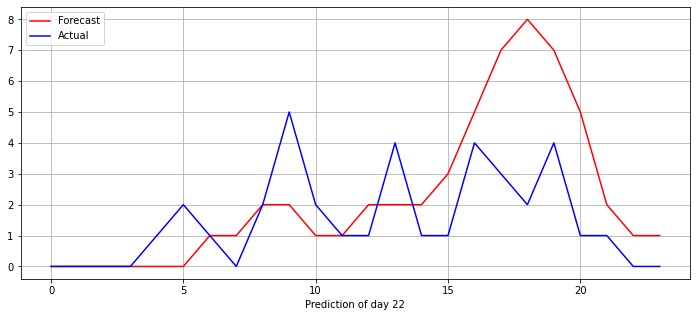

In [177]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

## PRUEBAS CON OTRAS ESTACIONES

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h & t-168h + Exogenous Variables (Temp. + Humidity)

### MODELO SIMPLE LOG1P

#### Estación 31200

In [9]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31200', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [10]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed (TimeDistri (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [11]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 4s 4s/step - loss: 1.6348 - mae: 1.0711
Epoch 2/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.5803 - mae: 1.0552
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5305 - mae: 1.0405
Epoch 4/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.4845 - mae: 1.0268
Epoch 5/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.4422 - mae: 1.0140
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.4029 - mae: 1.0020
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.3657 - mae: 0.9904
Epoch 8/10000
1/1 [==============================] - 0s 13ms/step - loss: 1.3310 - mae: 0.9794
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.2987 - mae: 0.9690
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.2687 - mae: 0.9591
Epoch 11/10000
1/1 [==============================] - 0s 8

In [12]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5230412762821592
 Test loss: 0.27357217669487
 Test mae: 0.3975852131843567
MSE = 6.189342975616455, RMSE = 2.48783901722287


MSE = 3.751908779144287, RMSE = 1.9369844550600521


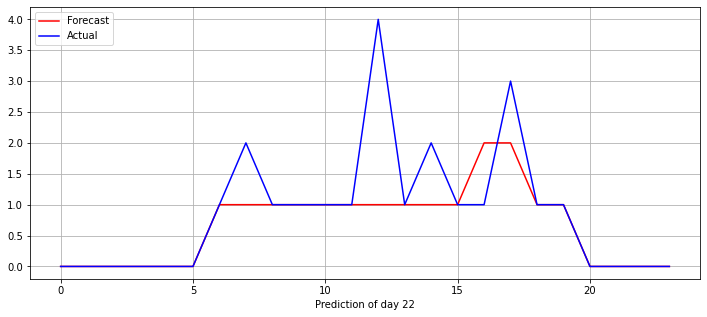

In [13]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31101

In [14]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31101', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [15]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [16]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 867ms/step - loss: 1.1188 - mae: 0.8769
Epoch 2/10000
1/1 [==============================] - 0s 115ms/step - loss: 1.0832 - mae: 0.8639
Epoch 3/10000
1/1 [==============================] - 0s 102ms/step - loss: 1.0492 - mae: 0.8512
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.0169 - mae: 0.8389
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.9861 - mae: 0.8268
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.9569 - mae: 0.8151
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.9291 - mae: 0.8038
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.9028 - mae: 0.7928
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8779 - mae: 0.7823
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.8544 - mae: 0.7722
Epoch 11/10000
1/1 [==============================] -

In [17]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5091431716216059
 Test loss: 0.2592267692089081
 Test mae: 0.3916912376880646
MSE = 4.300076007843018, RMSE = 2.0736624623701463


MSE = 3.633270263671875, RMSE = 1.9061139167615022


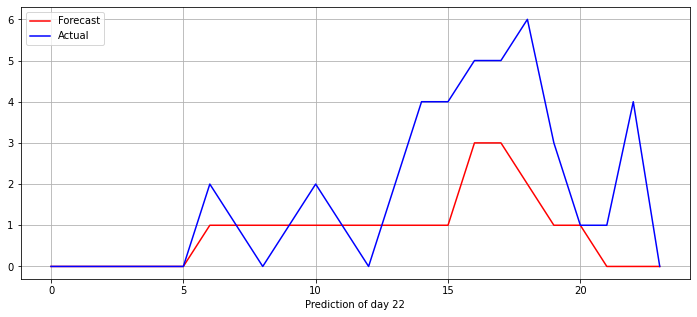

In [18]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31230

In [19]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31230', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [20]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_2 (TimeDist (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [21]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 698ms/step - loss: 1.3833 - mae: 0.7979
Epoch 2/10000
1/1 [==============================] - 0s 59ms/step - loss: 1.3757 - mae: 0.7977
Epoch 3/10000
1/1 [==============================] - 0s 90ms/step - loss: 1.3664 - mae: 0.7972
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3548 - mae: 0.7961
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3407 - mae: 0.7945
Epoch 6/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3241 - mae: 0.7923
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3053 - mae: 0.7896
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.2842 - mae: 0.7864
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.2610 - mae: 0.7827
Epoch 10/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.2362 - mae: 0.7786
Epoch 11/10000
1/1 [==============================] - 0

In [22]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5185623886772184
 Test loss: 0.26890695095062256
 Test mae: 0.3644910752773285
MSE = 4.015861511230469, RMSE = 2.0039614545271247


MSE = 2.113175392150879, RMSE = 1.4536765087703931


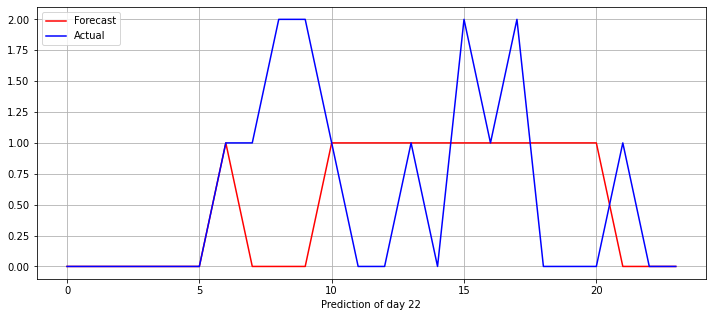

In [23]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31611

In [24]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31611', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [25]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_3 (TimeDist (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [26]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 702ms/step - loss: 0.8395 - mae: 0.6087
Epoch 2/10000
1/1 [==============================] - 0s 55ms/step - loss: 0.8145 - mae: 0.6016
Epoch 3/10000
1/1 [==============================] - 0s 56ms/step - loss: 0.7883 - mae: 0.5943
Epoch 4/10000
1/1 [==============================] - 0s 55ms/step - loss: 0.7607 - mae: 0.5871
Epoch 5/10000
1/1 [==============================] - 0s 67ms/step - loss: 0.7317 - mae: 0.5796
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.7017 - mae: 0.5720
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.6709 - mae: 0.5642
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.6399 - mae: 0.5564
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.6095 - mae: 0.5489
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.5805 - mae: 0.5420
Epoch 11/10000
1/1 [==============================] 

In [27]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.4950921468026771
 Test loss: 0.2451162338256836
 Test mae: 0.37394994497299194
MSE = 2.0459189414978027, RMSE = 1.4303562288806948


MSE = 1.3754769563674927, RMSE = 1.17280729720082


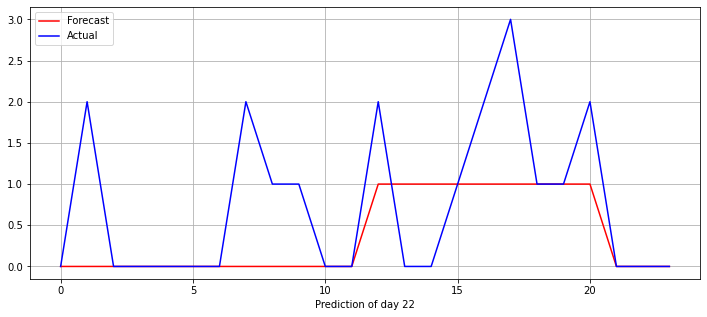

In [28]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### MODELO MAS DENSO LOG1P

#### Estación 31200

In [40]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31200', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [43]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_7 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
____________________________________________________

In [44]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 3.0195 - mae: 1.3994
Epoch 2/10000
1/1 [==============================] - 0s 138ms/step - loss: 3.0106 - mae: 1.3978
Epoch 3/10000
1/1 [==============================] - 0s 87ms/step - loss: 3.0016 - mae: 1.3961
Epoch 4/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.9926 - mae: 1.3944
Epoch 5/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.9834 - mae: 1.3927
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.9741 - mae: 1.3910
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.9647 - mae: 1.3892
Epoch 8/10000
1/1 [==============================] - 0s 15ms/step - loss: 2.9552 - mae: 1.3874
Epoch 9/10000
1/1 [==============================] - 0s 11ms/step - loss: 2.9456 - mae: 1.3856
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.9358 - mae: 1.3837
Epoch 11/10000
1/1 [==============================]

In [45]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5257568217663467
 Test loss: 0.2764202356338501
 Test mae: 0.39697349071502686
MSE = 6.41179895401001, RMSE = 2.5321530273682136


MSE = 3.7401578426361084, RMSE = 1.9339487693928472


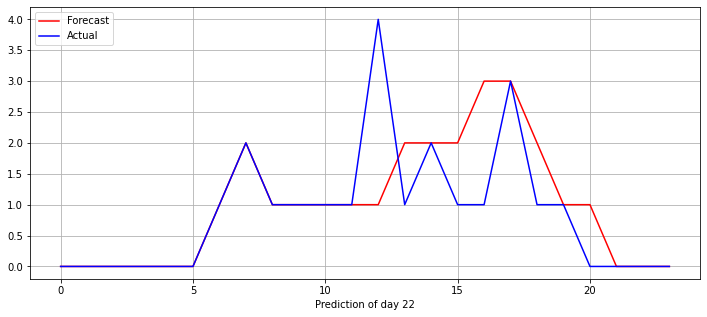

In [46]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31101

In [47]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31101', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [50]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_9 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
____________________________________________________

In [51]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.7956 - mae: 1.0596
Epoch 2/10000
1/1 [==============================] - 0s 39ms/step - loss: 1.7028 - mae: 1.0323
Epoch 3/10000
1/1 [==============================] - 0s 33ms/step - loss: 1.6109 - mae: 1.0042
Epoch 4/10000
1/1 [==============================] - 0s 34ms/step - loss: 1.5195 - mae: 0.9753
Epoch 5/10000
1/1 [==============================] - 0s 34ms/step - loss: 1.4305 - mae: 0.9461
Epoch 6/10000
1/1 [==============================] - 0s 43ms/step - loss: 1.3454 - mae: 0.9173
Epoch 7/10000
1/1 [==============================] - 0s 50ms/step - loss: 1.2650 - mae: 0.8893
Epoch 8/10000
1/1 [==============================] - 0s 35ms/step - loss: 1.1897 - mae: 0.8625
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.1196 - mae: 0.8369
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.0545 - mae: 0.8127
Epoch 11/10000
1/1 [==============================] 

In [52]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5116259366960523
 Test loss: 0.2617610991001129
 Test mae: 0.39442312717437744
MSE = 4.438256740570068, RMSE = 2.106717052802789


MSE = 3.601245880126953, RMSE = 1.8976948859410865


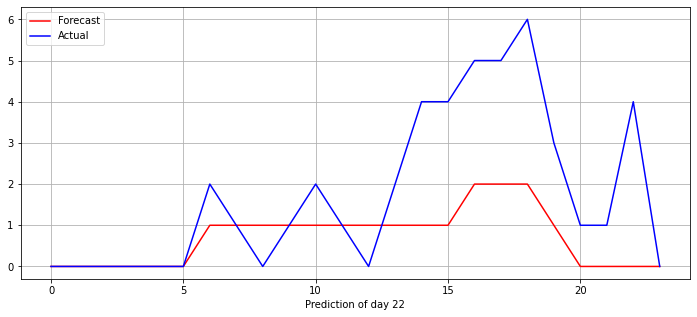

In [53]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31230

In [59]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31230', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [72]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_17 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [73]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.3761 - mae: 0.7999
Epoch 2/10000
1/1 [==============================] - 0s 39ms/step - loss: 1.3702 - mae: 0.7994
Epoch 3/10000
1/1 [==============================] - 0s 52ms/step - loss: 1.3644 - mae: 0.7988
Epoch 4/10000
1/1 [==============================] - 0s 51ms/step - loss: 1.3585 - mae: 0.7982
Epoch 5/10000
1/1 [==============================] - 0s 48ms/step - loss: 1.3528 - mae: 0.7977
Epoch 6/10000
1/1 [==============================] - 0s 42ms/step - loss: 1.3473 - mae: 0.7972
Epoch 7/10000
1/1 [==============================] - 0s 27ms/step - loss: 1.3419 - mae: 0.7967
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.3366 - mae: 0.7962
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3313 - mae: 0.7957
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.3261 - mae: 0.7952
Epoch 11/10000
1/1 [==============================] 

In [74]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5157710070952273
 Test loss: 0.266019731760025
 Test mae: 0.3681468069553375
MSE = 3.864508628845215, RMSE = 1.9658353514079492


MSE = 2.193661689758301, RMSE = 1.4811015123070737


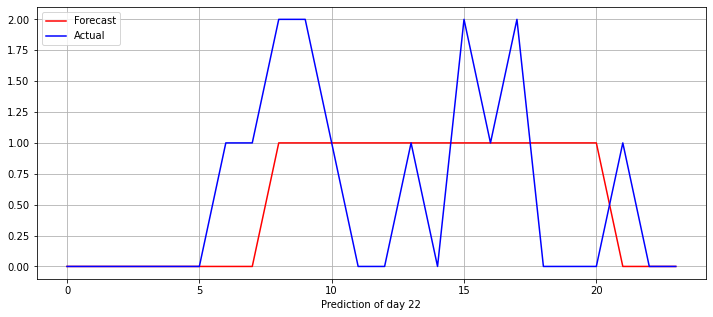

In [75]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31611

In [85]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31611', completeReturnsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [86]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_20 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [87]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 805ms/step - loss: 0.8090 - mae: 0.6282
Epoch 2/10000
1/1 [==============================] - 0s 32ms/step - loss: 0.7871 - mae: 0.6267
Epoch 3/10000
1/1 [==============================] - 0s 31ms/step - loss: 0.7667 - mae: 0.6254
Epoch 4/10000
1/1 [==============================] - 0s 31ms/step - loss: 0.7474 - mae: 0.6241
Epoch 5/10000
1/1 [==============================] - 0s 32ms/step - loss: 0.7296 - mae: 0.6229
Epoch 6/10000
1/1 [==============================] - 0s 30ms/step - loss: 0.7130 - mae: 0.6216
Epoch 7/10000
1/1 [==============================] - 0s 30ms/step - loss: 0.6974 - mae: 0.6203
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.6824 - mae: 0.6188
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.6678 - mae: 0.6171
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.6530 - mae: 0.6151
Epoch 11/10000
1/1 [=============================

In [88]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.4970516958291611
 Test loss: 0.2470603883266449
 Test mae: 0.3764139711856842
MSE = 2.085946559906006, RMSE = 1.444280637516825


MSE = 1.376975417137146, RMSE = 1.1734459583368746


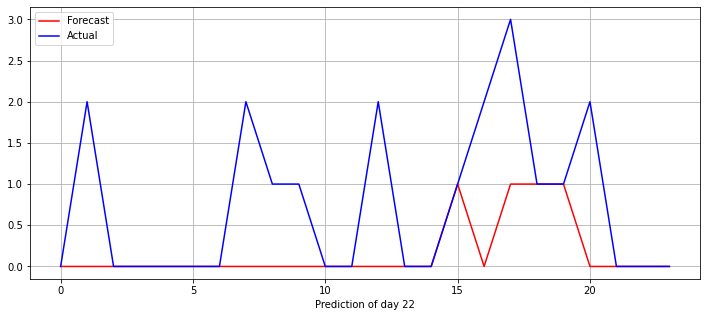

In [89]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)